<a href="https://colab.research.google.com/github/noahdanieldsouza/PAM-classification/blob/main/filteredHDBSCAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torchaudio numpy
!pip install git+https://github.com/google-research/perch-hoplite.git@782acd0e409eb27df51a695de4cb6608dae0db25

In [ ]:
import os
import torch
import torchaudio
import numpy as np
import csv
import gc
import tempfile

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

from perch_hoplite.agile import colab_utils, embed, source_info
from perch_hoplite.db import sqlite_usearch_impl
from perch_hoplite.zoo import model_configs
from perch_hoplite.agile.classifier import LinearClassifier

# --- Paths ---
db_path = '/content/drive/My Drive/classifier_training/DB'
classifier_path = '/content/drive/MyDrive/full_labeled_fish/DB/agile_classifier_v2.pt'


# --- Load DB + model ---
db = sqlite_usearch_impl.SQLiteUsearchDB.create(db_path)
db_model_config = db.get_metadata('model_config')
model_class = model_configs.get_model_class(db_model_config['model_key'])
embedding_model = model_class.from_config(db_model_config['model_config'])
embedding_ids = db.get_embedding_ids()
print(f"✅ loaded {len(embedding_ids)} embeddings")
id = embedding_ids[0]
vector = db.get_embedding(id)
print(f"✅ vector {vector}")

# --- Load classifier ---
classifier = LinearClassifier.load(classifier_path)
class_names = classifier.classes
print("✅ Loaded classifier with classes:", class_names)

train_set = []

#limit = 0;
for emb_id in embedding_ids:
    #limit += 1
    #if limit > 30000:
      #  break
    print (f"processing embedding: {emb_id}")
    vector = db.get_embedding(emb_id)
    print(vector.shape)

    train_set.append(vector)




print(np.shape(train_set))








Streaming output truncated to the last 5000 lines.
(1280,)
processing embedding: 30548
(1280,)
processing embedding: 30549
(1280,)
processing embedding: 30550
(1280,)
processing embedding: 30551
(1280,)
processing embedding: 30552
(1280,)
processing embedding: 30553
(1280,)
processing embedding: 30554
(1280,)
processing embedding: 30555
(1280,)
processing embedding: 30556
(1280,)
processing embedding: 30557
(1280,)
processing embedding: 30558
(1280,)
processing embedding: 30559
(1280,)
processing embedding: 30560
(1280,)
processing embedding: 30561
(1280,)
processing embedding: 30562
(1280,)
processing embedding: 30563
(1280,)
processing embedding: 30564
(1280,)
processing embedding: 30565
(1280,)
processing embedding: 30566
(1280,)
processing embedding: 30567
(1280,)
processing embedding: 30568
(1280,)
processing embedding: 30569
(1280,)
processing embedding: 30570
(1280,)
processing embedding: 30571
(1280,)
processing embedding: 30572
(1280,)
processing embedding: 30573
(1280,)
proce

In [ ]:
import librosa

# Paths where your actual WAV files are stored
base_paths = [
    "/content/drive/MyDrive/mass_data/cut2",
    "/content/drive/MyDrive/mass_data/cut1",
    "/content/drive/MyDrive/mass_data/cut",
]

cursor = db._get_cursor()

def find_file(source):
    """Check all base paths for an audio file."""
    for bp in base_paths:
        fp = os.path.join(bp, source)
        if os.path.exists(fp):
            return fp
    return None


# === Filtering thresholds ===
RMS_MIN            = 0.003    # drop near-silent ambient
BOAT_CENTROID_MAX  = 450      # Hz
BOAT_BANDWIDTH_MIN = 3000     # Hz

filtered_embeddings = []
filtered_ids = []

print("\n\n=== Running pre-clustering audio filtering ===")
i = 0
all_rms = []

for emb_id, vector in zip(embedding_ids, train_set):

    # --- Look up the audio filename ---
    cursor.execute(
        """
        SELECT hs.source
        FROM hoplite_embeddings he
        JOIN hoplite_sources hs ON he.source_idx = hs.id
        WHERE he.id = ?;
        """,
        (int(emb_id),),
    )
    row = cursor.fetchone()
    if row is None:
        continue

    source = row[0]
    file_path = find_file(source)
    print(f"Checking {source} → {file_path} -> {i}")
    i += 1

    if file_path is None:
        continue

    # --- Load raw audio (5 sec chunk) ---
    y, sr = librosa.load(file_path, sr=None)

    # ==========================
    # Acoustic features
    # ==========================

    rms = np.sqrt(np.mean(y**2))
    centroid = librosa.feature.spectral_centroid(y=y, sr=sr).mean()
    bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr).mean()
    all_rms.append(rms)

    is_boat = (
        centroid < BOAT_CENTROID_MAX and
        bandwidth > BOAT_BANDWIDTH_MIN
    )
    print(
        f"[{i}] {source}\n"
        f"     RMS       = {rms:.5f}\n"
        f"     Centroid  = {centroid:.1f} Hz\n"
        f"     Bandwidth = {bandwidth:.1f} Hz\n"
        f"     Boat?     = {is_boat}\n"
    )
    # ==========================
    # Filtering logic
    # ==========================
    if rms < RMS_MIN:
        print("     ➜ DROPPED: too quiet\n")
        continue

    if is_boat:
        print("     ➜ DROPPED: clear boat noise\n")
        continue

    print("     ✓ KEPT: non-boat\n")




    # --------------------------
    # KEEP → likely biotic / non-boat
    # --------------------------
    filtered_embeddings.append(vector)
    filtered_ids.append(emb_id)

print(f"\n=== Filtered down from {len(train_set)} → {len(filtered_embeddings)} segments ===")
filtered_embeddings = np.array(filtered_embeddings)
import numpy as np

print("RMS percentiles:")
for p in [1, 5, 10, 25, 50, 75, 90]:
    print(f"{p:>3}% : {np.percentile(all_rms, p):.6f}")



Streaming output truncated to the last 5000 lines.
     Boat?     = False

     ➜ DROPPED: too quiet

Checking 2.7chunk_002820_002825.wav → /content/drive/MyDrive/mass_data/cut2/2.7chunk_002820_002825.wav -> 21578
[21579] 2.7chunk_002820_002825.wav
     RMS       = 0.00037
     Centroid  = 10727.5 Hz
     Bandwidth = 13982.5 Hz
     Boat?     = False

     ➜ DROPPED: too quiet

Checking 2.7chunk_002825_002830.wav → /content/drive/MyDrive/mass_data/cut2/2.7chunk_002825_002830.wav -> 21579
[21580] 2.7chunk_002825_002830.wav
     RMS       = 0.00044
     Centroid  = 9151.7 Hz
     Bandwidth = 13152.9 Hz
     Boat?     = False

     ➜ DROPPED: too quiet

Checking 2.7chunk_002830_002835.wav → /content/drive/MyDrive/mass_data/cut2/2.7chunk_002830_002835.wav -> 21580
[21581] 2.7chunk_002830_002835.wav
     RMS       = 0.00052
     Centroid  = 9206.4 Hz
     Bandwidth = 13173.2 Hz
     Boat?     = False

     ➜ DROPPED: too quiet

Checking 2.7chunk_002835_002840.wav → /content/drive/MyDrive/ma

In [ ]:
import numpy as np

# Suppose this is your list of vectors
# train_set = [array([..1280..]), array([..1280..]), ...]

X = np.array(filtered_embeddings)
print(X.shape)   # (21600, 1280)

(10, 1280)


In [ ]:
from sklearn.decomposition import PCA

from sklearn.preprocessing import StandardScaler

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=5, random_state=42)
X_pca = pca.fit_transform(X_scaled)




In [ ]:
import umap

reducer = umap.UMAP(
    n_neighbors=40,
    min_dist=0.0,
    n_components=10
)
X_umap = reducer.fit_transform(X)
print (np.shape(X_umap))

/usr/local/lib/python3.12/dist-packages/umap/umap_.py:2462: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(
/usr/local/lib/python3.12/dist-packages/umap/spectral.py:519: RuntimeWarning: k >= N for N * N square matrix. Attempting to use scipy.linalg.eigh instead.
  eigenvalues, eigenvectors = scipy.sparse.linalg.eigsh(


TypeError: Cannot use scipy.linalg.eigh for sparse A with k >= N. Use scipy.linalg.eigh(A.toarray()) or reduce k.

In [ ]:
import hdbscan
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=2,        # force only large clusters
    min_samples=50,              # stabilizes cluster boundaries
    metric='euclidean',
    cluster_selection_epsilon=0.5,  # slightly merges nearby microclusters
    prediction_data=True
)
labels = clusterer.fit_predict(X_pca)

/usr/local/lib/python3.12/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


ValueError: zero-size array to reduction operation minimum which has no identity

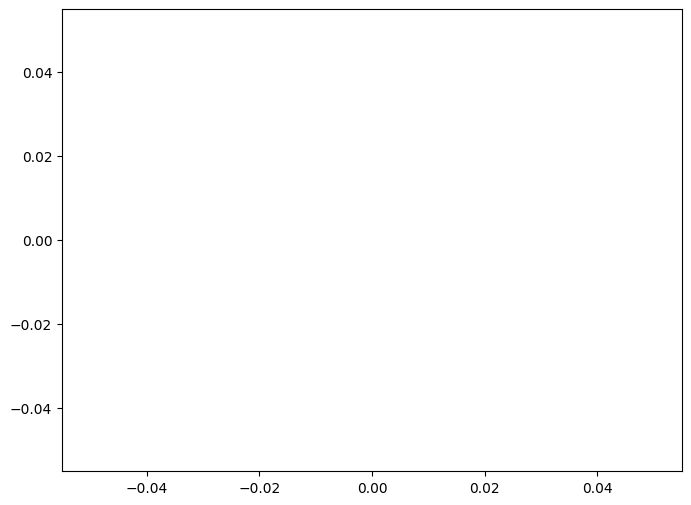

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# FORCE labels to be numeric
labels = labels.astype(int)

# Mask out noise
mask = labels != -1

plt.figure(figsize=(8,6))

# Scatter ONLY numeric labels (colors)
scatter = plt.scatter(
    X_pca[mask, 0],
    X_pca[mask, 1],
    c=labels[mask],            # <--- NUMBERS ONLY
    cmap="Spectral",
    s=5
)

# Build legend manually
unique_clusters = np.unique(labels[mask]).tolist()

# Create one legend patch per cluster
handles, _ = scatter.legend_elements()

plt.legend(
    handles=handles,
    labels=[f"Cluster {cid}" for cid in unique_clusters],
    bbox_to_anchor=(1.05, 1),
    title="Clusters"
)

plt.title("Clusters (excluding noise)")
plt.show()
unique_labels = np.unique(labels)


# Loop through each cluster
for cluster_id in unique_labels:
  cluster_indices = np.where(labels == cluster_id)[0]
  print(f"\n🎯 Cluster {cluster_id} — {len(cluster_indices)} embeddings")


In [ ]:
cursor = db._get_cursor()

In [ ]:
import os
import random
import numpy as np
import librosa
import IPython.display as ipd

# Define your base path for audio files
base_path = "/content/drive/MyDrive/mass_data/cut2"
base_path2 = "/content/drive/MyDrive/mass_data/cut1"
base_path3 = "/content/drive/MyDrive/mass_data/cut"

# Get all unique clusters (excluding noise if present)
unique_labels = np.unique(labels)


# Loop through each cluster
for cluster_id in unique_labels:
    cluster_indices = np.where(labels == cluster_id)[0]
    print(f"\n🎯 Cluster {cluster_id} — {len(cluster_indices)} embeddings")

    # Skip clusters with fewer than 2 samples
    if len(cluster_indices) < 2:
        print("Not enough samples to display (skipping)")
        continue

    # Randomly choose 2 embeddings from this cluster
    sample_indices = random.sample(list(cluster_indices), 2)

    for idx in sample_indices:
        embedding_id = int(embedding_ids[idx])

        # Query database for metadata
        cursor.execute(
            """
            SELECT
              he.id,
              hs.source,
              hs.dataset,
              he.offsets
            FROM hoplite_embeddings he
            JOIN hoplite_sources hs ON he.source_idx = hs.id
            WHERE he.id = ?;
            """,
            (embedding_id,),
        )
        row = cursor.fetchone()

        if not row:
            print(f"⚠️ No entry found for embedding_id {embedding_id}")
            continue

        _, source, dataset, _ = row
        file_path = os.path.join(base_path, source)

        if not os.path.exists(file_path):
            file_path = os.path.join(base_path2, source)
            if not os.path.exists(file_path):
              file_path = os.path.join(base_path3, source)
              if not os.path.exists(file_path):
                print(f"❌ File not found: {file_path}")
                continue

        print(f"\n▶️ Cluster {cluster_id}: {source}")
        y, sr = librosa.load(file_path, sr=None)
        display(ipd.Audio(y, rate=sr))



🎯 Cluster -1 — 25262 embeddings

▶️ Cluster -1: 6chunk_010065_010070.wav



▶️ Cluster -1: chunk_004170_004175.wav



🎯 Cluster 0 — 27 embeddings

▶️ Cluster 0: 2.1chunk_002340_002345.wav



▶️ Cluster 0: 2.1chunk_002350_002355.wav



🎯 Cluster 1 — 21 embeddings

▶️ Cluster 1: chunk_003585_003590.wav



▶️ Cluster 1: 2.9chunk_002675_002680.wav



🎯 Cluster 2 — 115 embeddings

▶️ Cluster 2: 2.7chunk_002365_002370.wav



▶️ Cluster 2: 2.7chunk_002095_002100.wav



🎯 Cluster 3 — 38 embeddings

▶️ Cluster 3: 4chunk_000015_000020.wav



▶️ Cluster 3: 2.7chunk_001230_001235.wav



🎯 Cluster 4 — 39 embeddings

▶️ Cluster 4: 2.1chunk_002795_002800.wav



▶️ Cluster 4: 2.1chunk_007695_007700.wav



🎯 Cluster 5 — 26 embeddings

▶️ Cluster 5: 2.4chunk_000610_000615.wav



▶️ Cluster 5: 2.4chunk_005285_005290.wav



🎯 Cluster 6 — 15 embeddings

▶️ Cluster 6: 2.8chunk_001755_001760.wav



▶️ Cluster 6: 2.8chunk_008495_008500.wav



🎯 Cluster 7 — 194 embeddings

▶️ Cluster 7: 5chunk_009545_009550.wav



▶️ Cluster 7: 2.8chunk_004590_004595.wav



🎯 Cluster 8 — 23 embeddings

▶️ Cluster 8: 2chunk_004085_004090.wav



▶️ Cluster 8: 2chunk_003120_003125.wav



🎯 Cluster 9 — 6899 embeddings

▶️ Cluster 9: 2.6chunk_006140_006145.wav



▶️ Cluster 9: 2.6chunk_008415_008420.wav



🎯 Cluster 10 — 21 embeddings

▶️ Cluster 10: 2.3chunk_004875_004880.wav



▶️ Cluster 10: 2.3chunk_004765_004770.wav



🎯 Cluster 11 — 366 embeddings

▶️ Cluster 11: 2.4chunk_008685_008690.wav



▶️ Cluster 11: 2.3chunk_005190_005195.wav


In [ ]:
test_point = X_pca[0].reshape(1, -1)
hdbscan.approximate_predict(clusterer, test_point)


(array([-1], dtype=int32), array([0.]))

In [ ]:
import joblib

joblib.dump(
    {
        "scaler": scaler,
        "pca": pca,       # your trained UMAP reducer
        "clusterer": clusterer # your trained HDBSCAN clusterer
    },
    "/content/drive/MyDrive/umap_clusterer_model.joblib"
)



['/content/drive/MyDrive/umap_clusterer_model.joblib']

In [ ]:
model = joblib.load("/content/drive/MyDrive/umap_clusterer_model.joblib")
print(model.keys())


dict_keys(['pca', 'clusterer'])
